# Tissue samples mapping

## Preparation

### Used imports

In [67]:
import openslide # Loading WSI images
import cv2 # Image processing
from scipy.spatial.distance import jensenshannon # Jensen-Shannon Distance
from PIL import Image
from skimage import io, color
from skimage.exposure import rescale_intensity, equalize_hist # ??
from skimage.color import separate_stains, hdx_from_rgb # Ruifrok and Johnston deconvolution
from skimage.metrics import structural_similarity # SSIM

import matplotlib.pyplot as plt
import numpy as np
import tifffile # Load processed images
import os
import heapq # Get only top N smallest
from joblib import Parallel, delayed # Parallel processing

### Define notebook static variables

In [68]:
data_dir = '../data/'
wsi_dir = data_dir + 'WSI_scans/'

wsi_scan = ['1M01.mrxs', '1M02.mrxs']

def sample_lod_path(lod: int, wsi_scan: str, num: int, mask: bool = False):
    sample_path = data_dir + f'Samples_LoD_{lod}/{wsi_scan}/{num}.tiff' 
    if mask:
        return sample_path, data_dir + f'Samples_LoD_{lod}/{wsi_scan}/{num}_mask.tiff'
    else:
        return sample_path

### Notebook parameters

In [69]:
scan_lod = 2
used_wsi_scan = wsi_scan[0]
override_saved = False

img_pyramid_levels = 5

### Load tissue scans

In [70]:
sample_imgs = []
sample_masks = []

i = 0
while True:
    path = sample_lod_path(scan_lod, used_wsi_scan, i, True)

    if not os.path.exists(path[0]) or not os.path.exists(path[1]):
        print(f'Loaded {i} tissue samples with masks')
        break
    print(f'Loading {path[0]} ...')
    sample_imgs.append(tifffile.imread(path[0]))
    sample_masks.append(tifffile.imread(path[1]))

    i += 1

#
# Used examples
#

img1 = sample_imgs[0]
img2 = sample_imgs[1]

# Rescaled image
down_img1 = cv2.resize(img1, None, fx=0.5, fy=0.5, interpolation=cv2.INTER_AREA)
down_img2 = cv2.resize(img1, None, fx=0.5, fy=0.5, interpolation=cv2.INTER_AREA)

# Convert to gray scale
gray1 = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

# Rescaled gray image
down_gray1 = cv2.cvtColor(down_img1, cv2.COLOR_RGB2GRAY)
down_gray2 = cv2.cvtColor(down_img2, cv2.COLOR_RGB2GRAY)

# Create img pyramid
img1_pyr = [img1]
img2_pyr = [img2]
gray1_pyr = [gray1]
gray2_pyr = [gray2]

for level in range(img_pyramid_levels-1):
    img1_pyr.append(cv2.pyrDown(img1_pyr[-1]))
    img2_pyr.append(cv2.pyrDown(img2_pyr[-1]))
    gray1_pyr.append(cv2.pyrDown(gray1_pyr[-1]))
    gray2_pyr.append(cv2.pyrDown(gray2_pyr[-1]))

img1_pyr.reverse()
img2_pyr.reverse()
gray1_pyr.reverse()
gray2_pyr.reverse()

mask1 = sample_masks[0]
mask2 = sample_masks[1]

Loading ../data/Samples_LoD_2/1M01.mrxs/0.tiff ...


Loading ../data/Samples_LoD_2/1M01.mrxs/1.tiff ...
Loading ../data/Samples_LoD_2/1M01.mrxs/2.tiff ...
Loaded 3 tissue samples with masks


### Used functions (from other notebooks)

In [71]:
# R&J deconvoluted image
def hdx_split(img: np.ndarray):
    stain_matrix = hdx_from_rgb
    deconvoluted = separate_stains(img, stain_matrix)
    
    return deconvoluted[...,:-1]

## Key points detection

### PoI functions

In [72]:
def get_kp_des(feature: cv2.Feature2D, img: np.ndarray, v: bool = False):
    kp, des = feature.detectAndCompute(img, None)
    if v:
        return kp, des, cv2.drawKeypoints(img,kp,None)
    else:
        return kp, des

### Scale-invariant feature transform (SIFT)

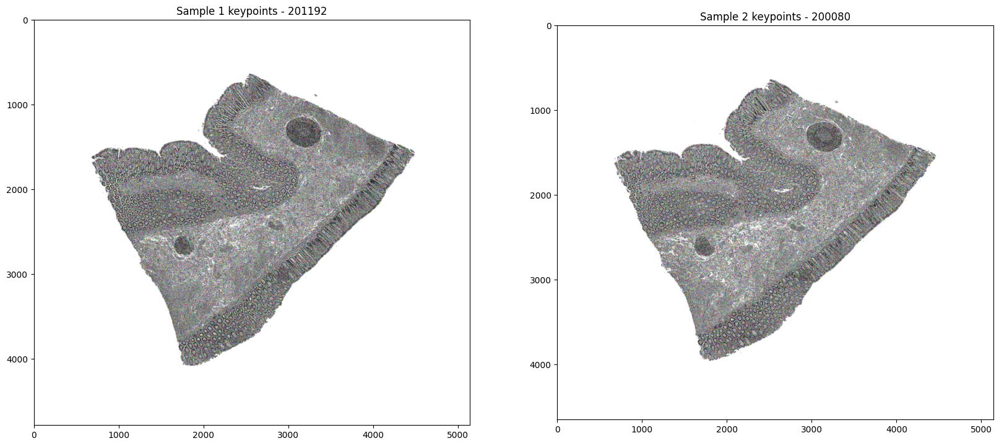

In [73]:
sift = cv2.SIFT_create()

sift_kp1, sift_des1 = sift.detectAndCompute(gray1, None)
sift_kp2, sift_des2 = sift.detectAndCompute(gray2, None)

sift_kp_img1=cv2.drawKeypoints(gray1,sift_kp1,None)
sift_kp_img2=cv2.drawKeypoints(gray2,sift_kp2,None)

fig, axes = plt.subplots(1, 2, figsize=(20,20))
axes[0].imshow(sift_kp_img1)
axes[0].set_title(f'Sample 1 keypoints - {len(sift_kp1)}')
axes[1].imshow(sift_kp_img2)
axes[1].set_title(f'Sample 2 keypoints - {len(sift_kp2)}')
plt.show()

### Downscaled Scale-invariant feature transform (SIFT)

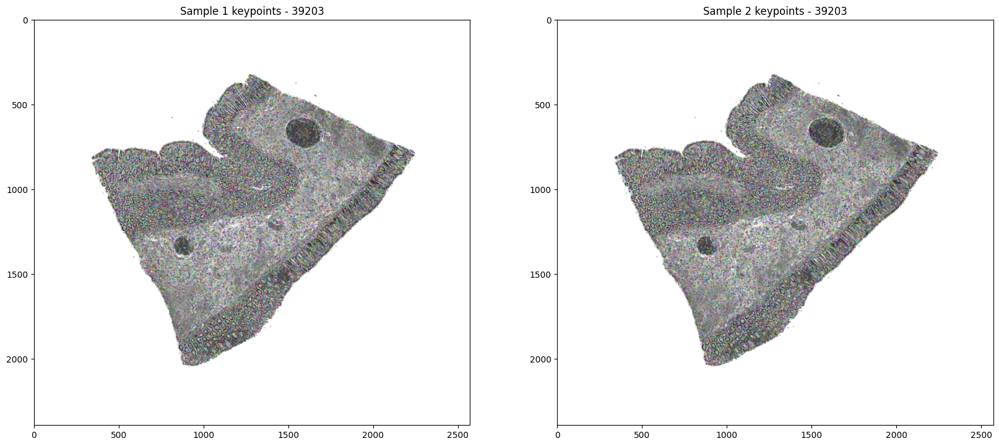

In [74]:
down_sift_kp1, down_sift_des1 = sift.detectAndCompute(down_gray1, None)
down_sift_kp2, down_sift_des2 = sift.detectAndCompute(down_gray2, None)

down_sift_kp_img1=cv2.drawKeypoints(down_gray1,down_sift_kp1,None)
down_sift_kp_img2=cv2.drawKeypoints(down_gray2,down_sift_kp2,None)

fig, axes = plt.subplots(1, 2, figsize=(20,20))
axes[0].imshow(down_sift_kp_img1)
axes[0].set_title(f'Sample 1 keypoints - {len(down_sift_kp1)}')
axes[1].imshow(down_sift_kp_img2)
axes[1].set_title(f'Sample 2 keypoints - {len(down_sift_kp2)}')
plt.show()

### Pyramid Scale-invariant feature transform (SIFT)

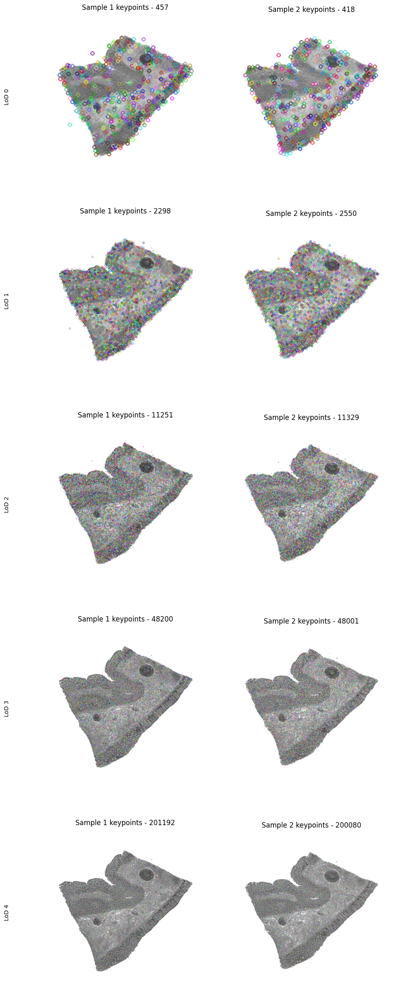

In [75]:
pyramid_sift_kp1 = []
pyramid_sift_kp2 = []
pyramid_sift_des1 = []
pyramid_sift_des2 = []

fig, axes = plt.subplots(img_pyramid_levels, 2, figsize=(10, 5*img_pyramid_levels))

for i, (img1, img2, gray1, gray2) in enumerate(zip(img1_pyr, img2_pyr, gray1_pyr, gray2_pyr)):
    kp1, des1 = sift.detectAndCompute(gray1, None)
    kp2, des2 = sift.detectAndCompute(gray2, None)

    kp_img1=cv2.drawKeypoints(gray1,kp1,None)
    kp_img2=cv2.drawKeypoints(gray2,kp2,None)

    axes[i, 0].set_title(f'Sample 1 keypoints - {len(kp1)}')
    axes[i, 0].imshow(kp_img1)
    axes[i, 1].set_title(f'Sample 2 keypoints - {len(kp2)}')
    axes[i, 1].imshow(kp_img2)
    axes[i, 0].set_ylabel(f'LoD {i}', rotation=90, labelpad=50, va='center')
    
    pyramid_sift_kp1.append(kp1)
    pyramid_sift_kp2.append(kp2)
    pyramid_sift_des1.append(des1)
    pyramid_sift_des2.append(des2)

for ax in axes.flat:
    ax.set_xticks([])
    ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)

plt.tight_layout()
plt.show()

### Oriented FAST and Rotated BRIEF (ORB)

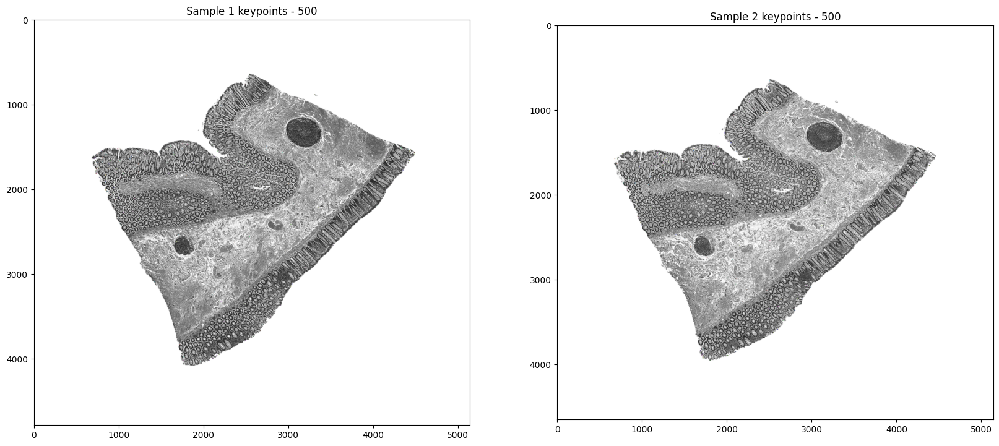

In [76]:
orb = cv2.ORB_create()

orb_kp1, orb_des1 = orb.detectAndCompute(gray1, None)
orb_kp2, orb_des2 = orb.detectAndCompute(gray2, None)

orb_kp_img1=cv2.drawKeypoints(gray1,orb_kp1,None)
orb_kp_img2=cv2.drawKeypoints(gray2,orb_kp2,None)

fig, axes = plt.subplots(1, 2, figsize=(20,20))
axes[0].imshow(orb_kp_img1)
axes[0].set_title(f'Sample 1 keypoints - {len(orb_kp1)}')
axes[1].imshow(orb_kp_img2)
axes[1].set_title(f'Sample 2 keypoints - {len(orb_kp2)}')
plt.show()

### Simple Blob Detector

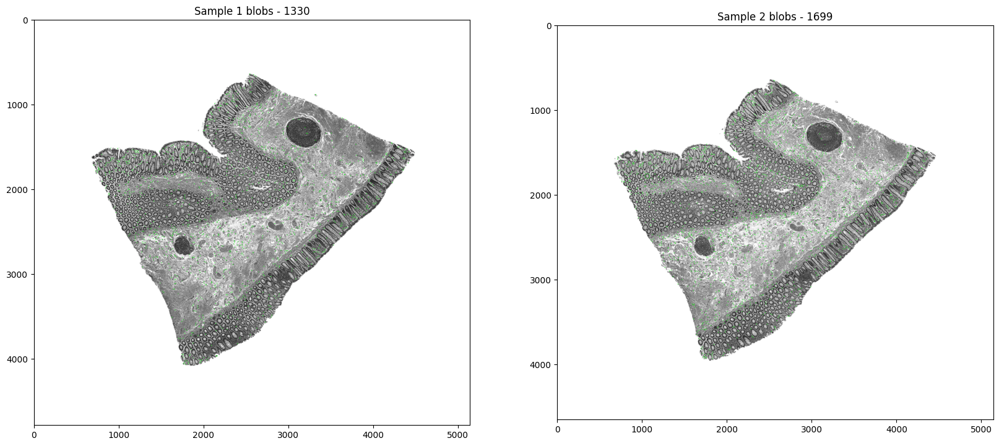

In [77]:
blob_detector = cv2.SimpleBlobDetector_create()

# Detect blobs in both images
blob1 = blob_detector.detect(gray1, None)
blob2 = blob_detector.detect(gray2, None)

# Convert the grayscale images to 3-channel (color) images
img1_with_blobs = cv2.cvtColor(gray1, cv2.COLOR_GRAY2BGR)
img2_with_blobs = cv2.cvtColor(gray2, cv2.COLOR_GRAY2BGR)

# Draw circles around each detected blob on the images
for kp in blob1:
    # Draw green circle around each blob
    cv2.circle(img1_with_blobs, (int(kp.pt[0]), int(kp.pt[1])), int(kp.size / 2), (0, 255, 0), 2)

for kp in blob2:
    # Draw green circle around each blob
    cv2.circle(img2_with_blobs, (int(kp.pt[0]), int(kp.pt[1])), int(kp.size / 2), (0, 255, 0), 2)

# Display the images with blobs drawn on them
fig, axes = plt.subplots(1, 2, figsize=(20, 20))
axes[0].imshow(img1_with_blobs)
axes[0].set_title(f'Sample 1 blobs - {len(blob1)}')
axes[1].imshow(img2_with_blobs)
axes[1].set_title(f'Sample 2 blobs - {len(blob2)}')
plt.show()

## Matching key points

### Define used functions

In [78]:
# Filter matches with Lowe's ratio test
def map_H(img1: np.ndarray, img2: np.ndarray, H: np.ndarray):
    return cv2.warpPerspective(img1, H, (img2.shape[1], img2.shape[0]),borderMode=cv2.BORDER_REPLICATE)

def lowes_ratio(matches: list, ratio: float = 0.75):
    good_matches = []
    for m_n in matches:
        if len(m_n) != 2:
            continue
        m, n = m_n
        if m.distance < ratio * n.distance:
            good_matches.append(m)
    return good_matches

def kp_match(kp_des1: tuple, kp_des2: tuple, 
             matcher: cv2.DescriptorMatcher, best_prc: float = 1.0,
             mutual: bool = True, return_matches: bool = False):

    assert kp_des1 is not None and len(kp_des1) == 2
    assert kp_des2 is not None and len(kp_des2) == 2
    assert 0 < best_prc <= 1.0

    kp1, des1 = kp_des1
    kp2, des2 = kp_des2

    matches = matcher.knnMatch(des1, des2, k=2)
    matches = lowes_ratio(matches)

    # Filter only two-way matches if mutual flag set
    if mutual:
        matched_mut = matcher.knnMatch(des2, des1, k=2)
        matched_mut = lowes_ratio(matched_mut)
         
        rev_lookup = {(m.trainIdx, m.queryIdx) for m in matched_mut}
        matches = [m for m in matches if (m.queryIdx, m.trainIdx) in rev_lookup]

    # Calculate element count and get smallest
    elem_c = np.ceil(len(matches) * best_prc).astype(int)
    mm = heapq.nsmallest(elem_c, matches, key=lambda x: x.distance)
    
    if len(mm) < 4:
        if return_matches:
            return None, mm
        return None
    
    src_pts = np.float32([kp1[m.queryIdx].pt for m in mm]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in mm]).reshape(-1, 1, 2) 

    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    if return_matches:
        return H, mm
    return H

def img_grad(img1: np.ndarray, img2: np.ndarray):
    diff = img2.astype(np.float32) - img1.astype(np.float32)
    magnitude_squared = np.sum(diff ** 2, axis=-1)
    return magnitude_squared

def compare_plot(img1: np.ndarray, kp1, img2: np.ndarray, kp2, imgH: np.ndarray, matches, ax):
    assert len(ax) == 3
    match_img = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    ax[0].imshow(match_img)
    grad_img = img_grad(img2, imgH)
    ax[1].imshow(grad_img)
    ax[2].imshow(img2)
                    
def plot_test_match(img1: np.ndarray, img2: np.ndarray, kp_des1: tuple, kp_des2: tuple,
                    matcher: cv2.DescriptorMatcher, key_point_prc: list = [1.0],
                    mutual: bool = True, title: str = '', n_jobs: int = -1):
    
    fig, axes = plt.subplots(len(key_point_prc), 3, figsize=(20, 20), gridspec_kw={'width_ratios': [1.5, 1, 1]})
    fig.suptitle(title, fontsize=18, y=0.98)
    
    axes[0, 0].set_title('Matched keypoints', fontsize=14)
    axes[0, 1].set_title('Transformed sample', fontsize=14)
    axes[0, 2].set_title('Overlayed samples', fontsize=14)

    # Match in parallel to evaluate Homographies
    results = Parallel(n_jobs=n_jobs, backend='threading')(
        delayed(kp_match)(kp_des1, kp_des2, matcher, prc, mutual, True)
        for prc in key_point_prc
    )

    all_homographies = []

    # Plot results
    for i, (H, matches) in enumerate(results):
        if H is None:
            continue
        all_homographies.append(H)

        axes[i, 0].set_ylabel(f'{key_point_prc[i] * 100:.0f}% keypoints - {len(matches)} matches',
                              fontsize=14, rotation=90, labelpad=50, va='center')
        imgH = map_H(img1, img2, H)
        compare_plot(
            img1, kp_des1[0],
            img2, kp_des2[0],
            imgH,
            matches,
            axes[i]
        )
        
    for ax in axes.flat:
        ax.set_xticks([])
        ax.set_yticks([])
        for spine in ax.spines.values():
            spine.set_visible(False)

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

    return all_homographies

### Second to First matching

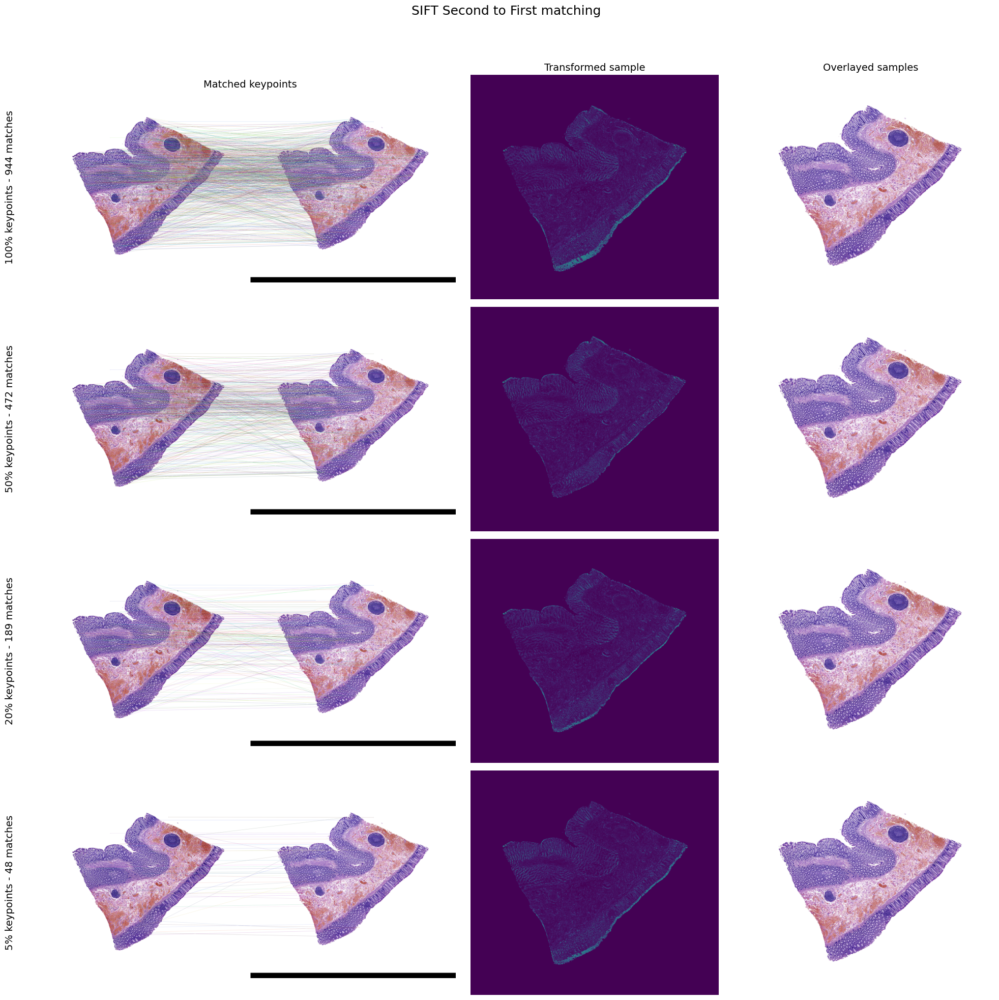

In [79]:
res_dict = {}

# Best key point percent evaluated
key_point_prc = [1, .5, .2, 0.05]

res_dict['Sift second to First'] = plot_test_match(
    img1, img2, 
    (sift_kp1, sift_des1), (sift_kp2, sift_des2),
    
    matcher=cv2.FlannBasedMatcher({'algorithm':1, 'trees':5}, {'checks':50}),
    key_point_prc=key_point_prc,
    mutual=False,

    title='SIFT Second to First matching'
)

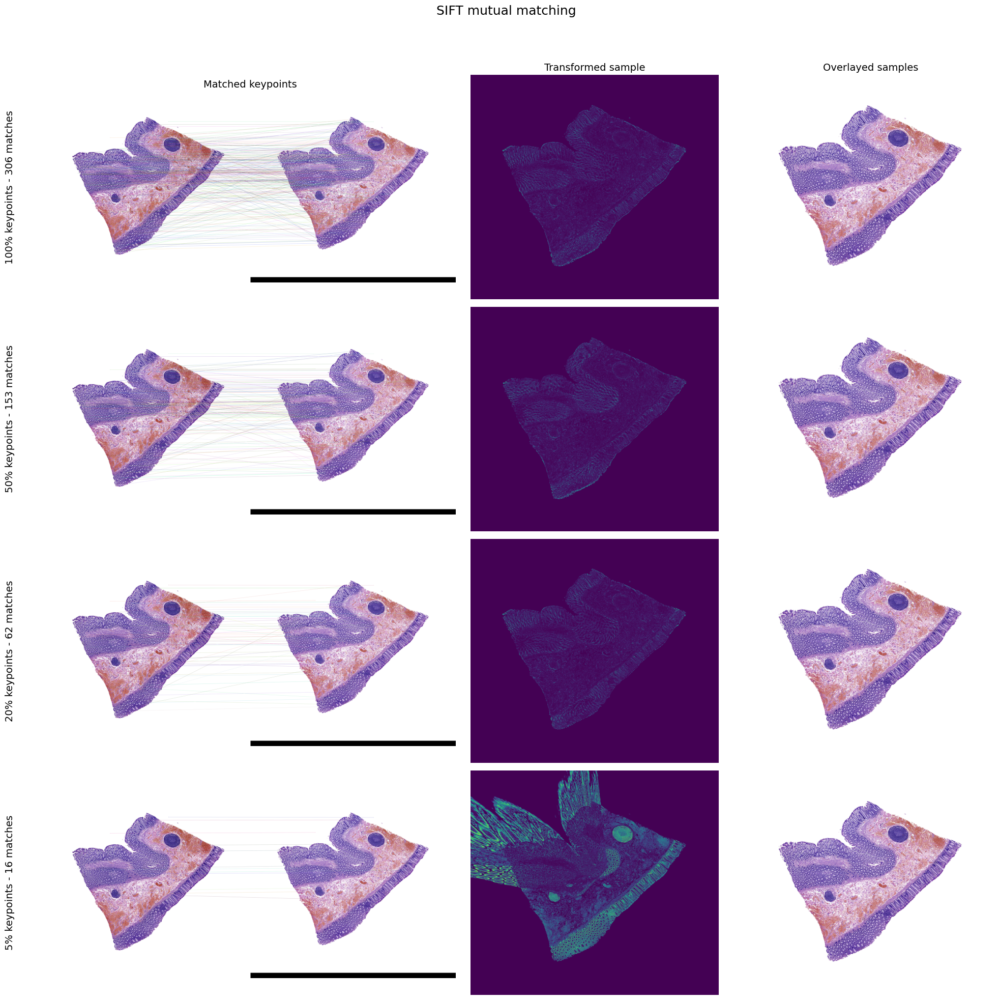

In [80]:
# Best key point percent evaluated
key_point_prc = [1, .5, .2, 0.05]

res_dict['Sift mutual matching'] = plot_test_match(
    img1, img2, 
    (sift_kp1, sift_des1), (sift_kp2, sift_des2),
    
    matcher=cv2.FlannBasedMatcher({'algorithm':1, 'trees':5}, {'checks':50}),
    key_point_prc=key_point_prc,
    mutual=True,

    title='SIFT mutual matching'
)

### Low resolution mutual matching

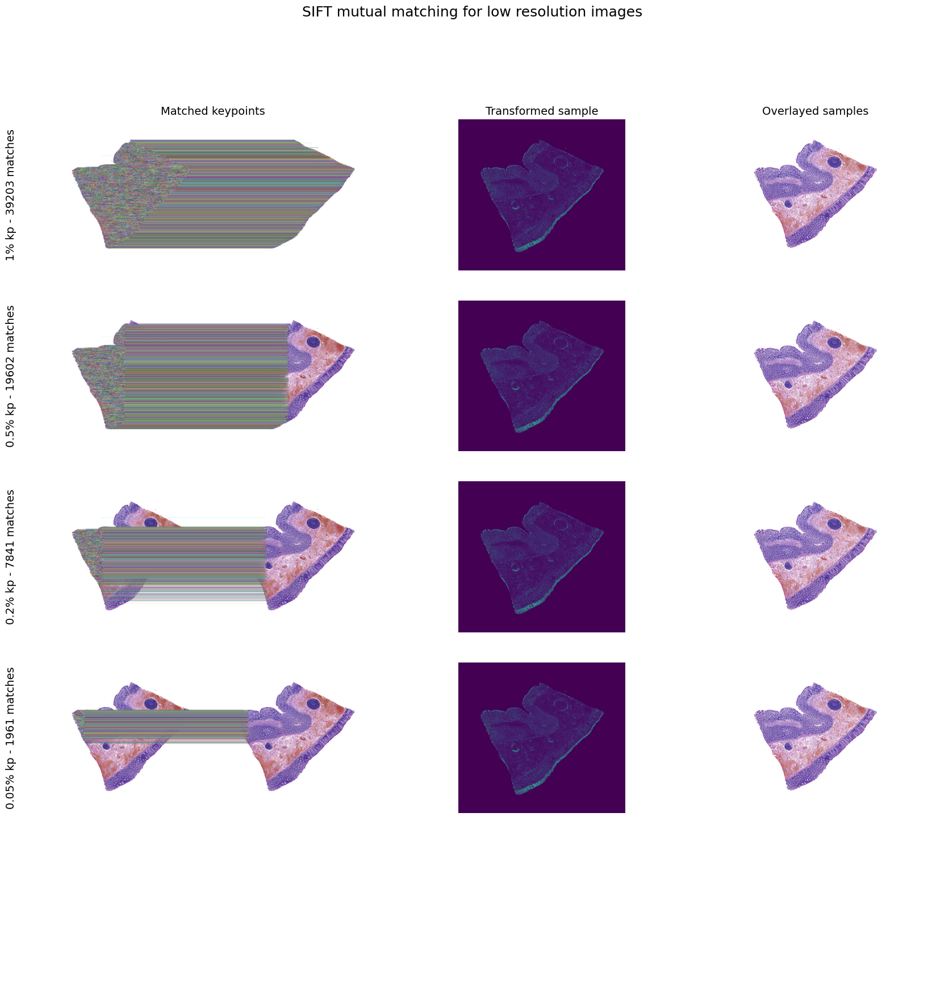

In [81]:
fig, axes = plt.subplots(img_pyramid_levels, 3, figsize=(20, 20), gridspec_kw={'width_ratios': [1.5, 1, 1]})
fig.suptitle("SIFT mutual matching for low resolution images", fontsize=18, y=0.98)

axes[0, 0].set_title('Matched keypoints', fontsize=14)
axes[0, 1].set_title('Transformed sample', fontsize=14)
axes[0, 2].set_title('Overlayed samples', fontsize=14)

homographies = []

for i, prc in enumerate(key_point_prc): 
    H_new, matches = kp_match( 
        (down_sift_kp1, down_sift_des1), (down_sift_kp2, down_sift_des2),
        
        matcher = cv2.FlannBasedMatcher({'algorithm':1, 'trees':5}, {'checks':50}),
        best_prc=prc,
        mutual=False,
        return_matches=True
    )

    S = np.array([
        [2, 0, 0],
        [0, 2, 0],
        [0, 0, 1]
    ])
    H_new = S @ H_new @ np.linalg.inv(S)
    
    imgH = map_H(img1, img2, H_new)
    axes[i, 0].set_ylabel(f'{prc}% kp - {len(matches)} matches', rotation=90, labelpad=50, va='center', fontsize=14)
    match_img = cv2.drawMatches(down_img1, down_sift_kp1, down_img2, down_sift_kp2, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    axes[i,0].imshow(match_img)
    grad_img = img_grad(img2, imgH)
    axes[i,1].imshow(grad_img)
    axes[i,2].imshow(img2)
    homographies.append(H_new)
    
res_dict['Sift low resolution matching'] = homographies

for ax in axes.flat:
    ax.set_xticks([])
    ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)

### Pyramid mutual matching

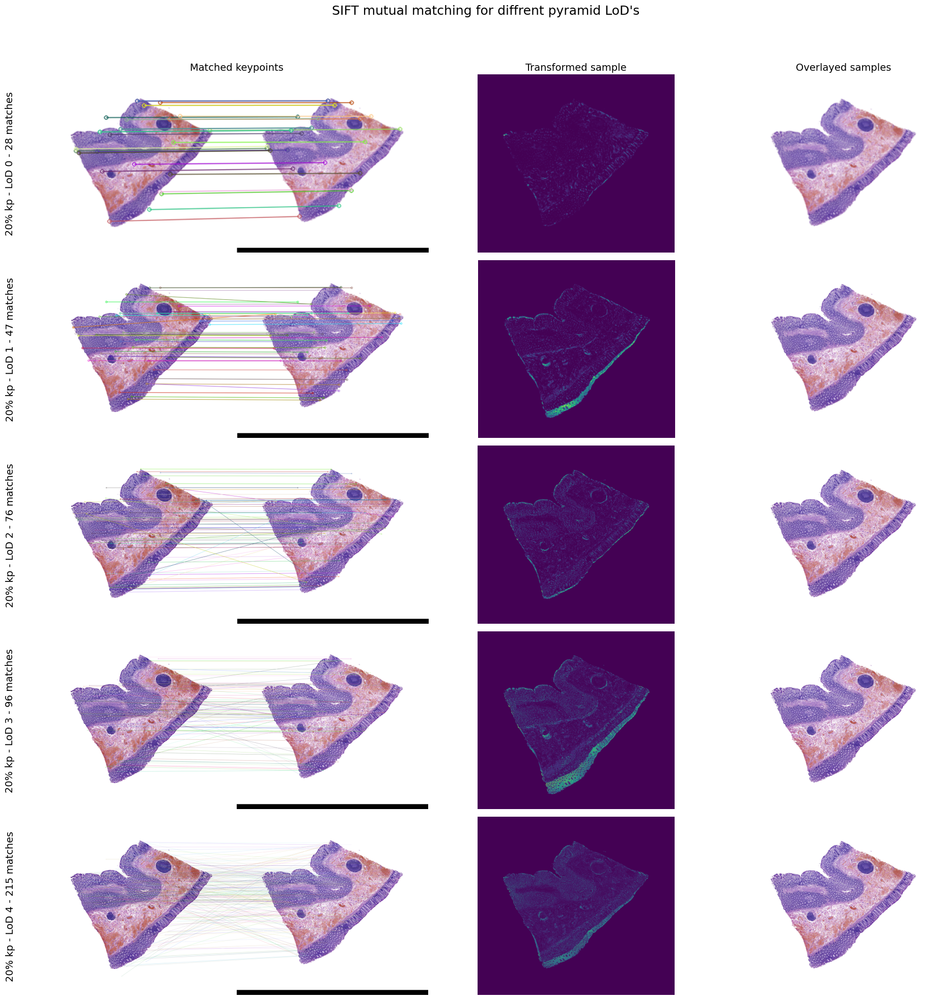

In [82]:
fig, axes = plt.subplots(img_pyramid_levels, 3, figsize=(20, 20), gridspec_kw={'width_ratios': [1.5, 1, 1]})
fig.suptitle("SIFT mutual matching for diffrent pyramid LoD's", fontsize=18, y=0.98)

axes[0, 0].set_title('Matched keypoints', fontsize=14)
axes[0, 1].set_title('Transformed sample', fontsize=14)
axes[0, 2].set_title('Overlayed samples', fontsize=14)

H = np.eye(3)

for i, (img1, img2, gray1, gray2) in enumerate(zip(img1_pyr, img2_pyr, gray1_pyr, gray2_pyr)): 
    warped1 = map_H(img1, img2, H)

    kp1, des1 = get_kp_des(sift, warped1)
    kp2, des2 = get_kp_des(sift, img2)
    
    H_new, matches = kp_match(
        (kp1, des1), (kp2, des2),
        
        matcher = cv2.FlannBasedMatcher({'algorithm':1, 'trees':5}, {'checks':50}),
        best_prc=0.2,
        mutual=False,
        return_matches=True
    )

    imgH = map_H(img1, img2, H_new)
    axes[i, 0].set_ylabel(f'20% kp - LoD {i} - {len(matches)} matches', rotation=90, labelpad=50, va='center', fontsize=14)
    compare_plot(
        img1, kp1,
        img2, kp2,
        imgH,
        matches,
        axes[i]
    )
    
    if i < img_pyramid_levels - 1:
        S     = np.diag([2.0, 2.0, 1.0])
        S_inv = np.linalg.inv(S)
        H_up  = S @ H @ S_inv
    else:
        H_up = H

    H = H_up @ H_new

for ax in axes.flat:
    ax.set_xticks([])
    ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)

res_dict['Pyramid SIFT mututal matching'] = [H]

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

### Oriented FAST and Rotated BRIEF (ORB)

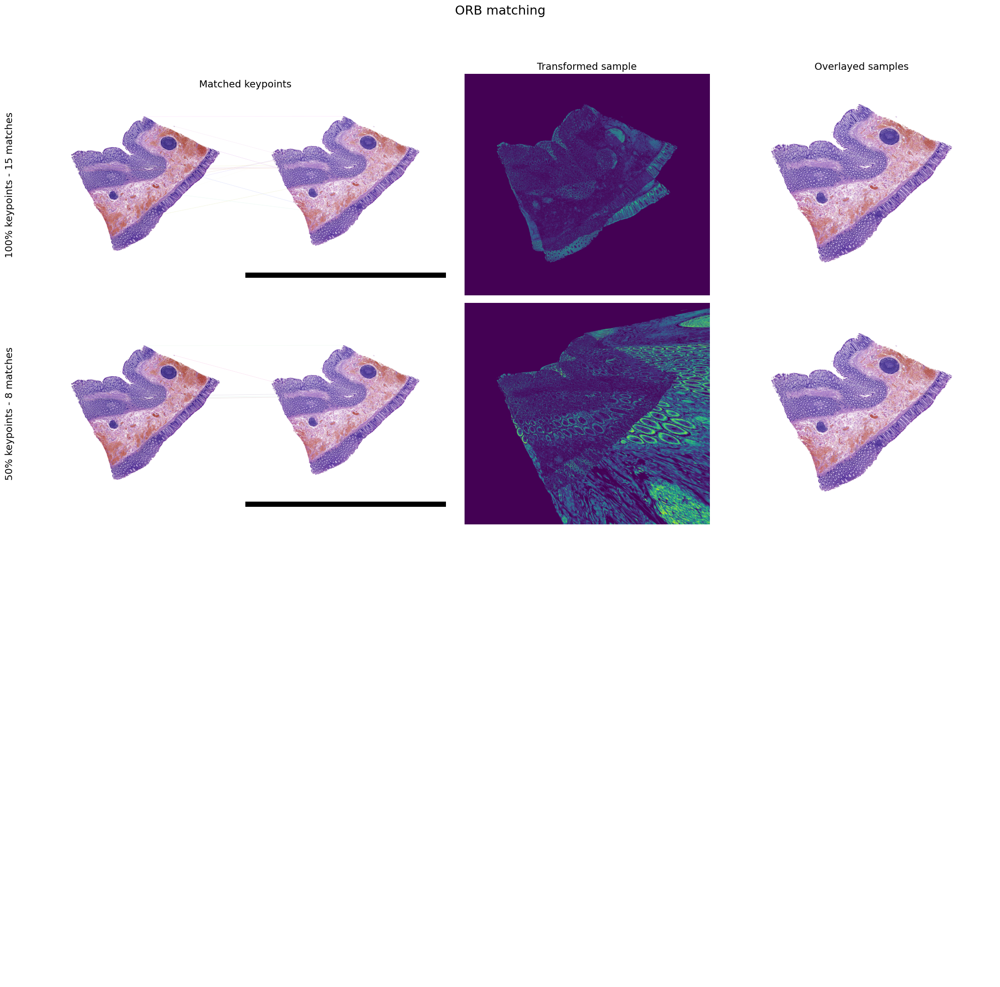

In [83]:
# Best key point percent evaluated
key_point_prc = [1, .5, .2, 0.05]

res_dict['ORB Second to First matching'] = plot_test_match(
    img1, img2, 
    (orb_kp1, orb_des1), (orb_kp2, orb_des2),
    
    matcher=cv2.BFMatcher(),
    key_point_prc=key_point_prc,
    mutual=False,
    
    title='ORB matching'
)

## Mapping accuracy measure

### Used functions

In [84]:
def plot_index(match_dict: dict, index_func, ax):
    indexes = []
    for name, (img1, img2) in match_dict.items():
        indexes.append(index_func(img1, img2))
    bars = ax.bar(match_dict.keys(), indexes)
    ax.bar_label(bars, labels=[f'{v:.4f}' for v in indexes], padding=3 )
    ax.tick_params(axis='x', labelrotation=90)
    return indexes

### Precalculate homographies

In [88]:
match_dict = {}

for name, H in res_dict.items():
    hdx1 = hdx_split(img1)
    hdx2 = hdx_split(img2)
    mapped = map_H(hdx1, hdx2, H[0])
    match_dict[name] = (mapped, hdx2)

### Mean square error (MSE) and Mean absolute error(MAE)

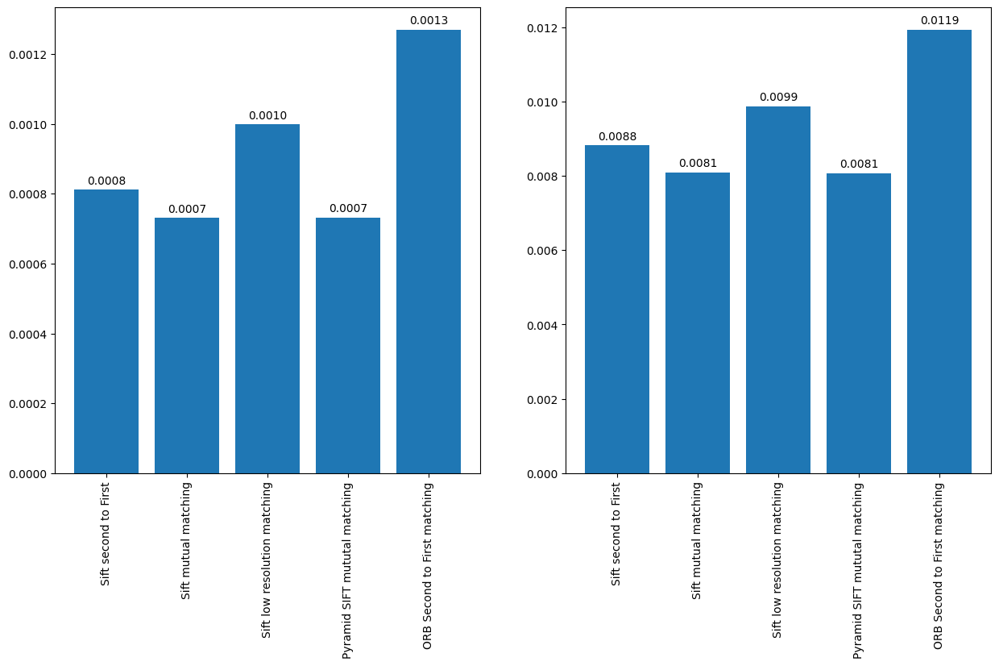

In [89]:
def mse(img1: np.ndarray, img2: np.ndarray):
    return np.mean((img1 - img2)**2)

def mae(img1: np.ndarray, img2: np.ndarray):
    return np.mean(np.abs(img1 - img2))

fig, axes = plt.subplots(1, 2, figsize=(15,7.5))
index_mse = plot_index(match_dict, mse, axes[0])
index_mae = plot_index(match_dict, mae, axes[1])
plt.show()

### Jackard Index

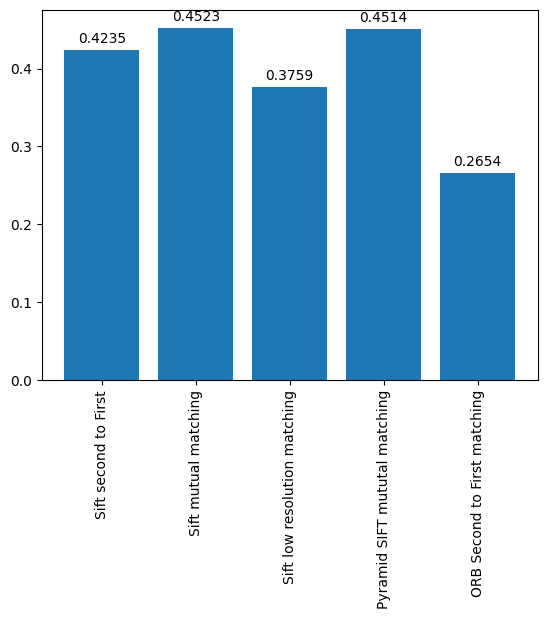

In [90]:
def jaccard_index(A: np.ndarray, B: np.ndarray):
    intersection = np.sum(np.minimum(A, B))
    union = np.sum(np.maximum(A, B))

    return intersection / union if union != 0 else 1.0

fig, ax = plt.subplots()
index_jackard = plot_index(match_dict, jaccard_index, ax)
plt.show()

### Mutual information measure (MI)

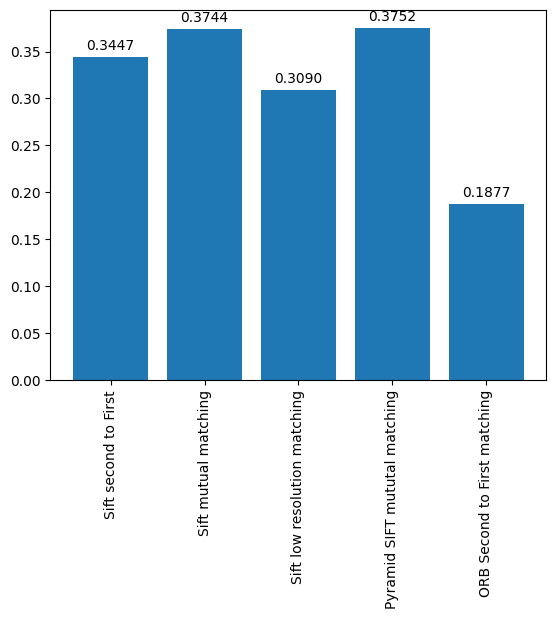

In [91]:
def mutual_information(image1: np.ndarray, image2: np.ndarray):
    hist2d, _, _ = np.histogram2d(image1.ravel(), image2.ravel(), bins=256, range=[[0.0, 1.0], [0.0, 1.0]])

    # Normalization
    pxy = hist2d / float(np.sum(hist2d))

    px = np.sum(pxy, axis=1)  
    py = np.sum(pxy, axis=0)

    px_py = np.outer(px, py)

    nz = pxy > 0
    return np.sum(pxy[nz] * np.log(pxy[nz] / px_py[nz]))

fig, ax = plt.subplots()
index_mi = plot_index(match_dict, mutual_information, ax)
plt.show()

### Structural similarity index measure (SSIM)

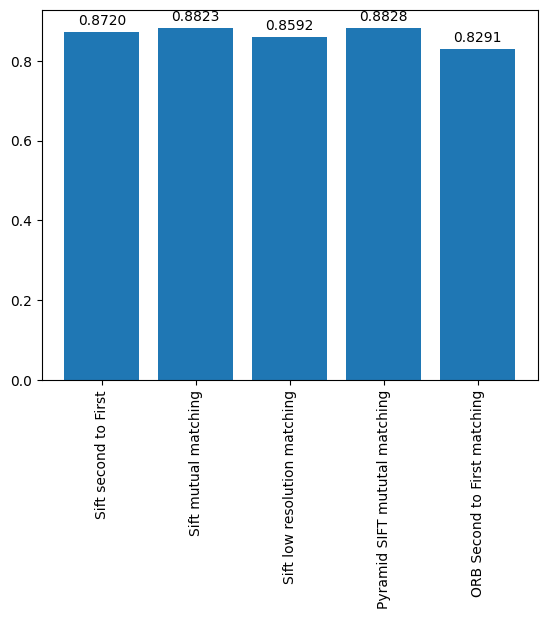

In [92]:
def multi_channel_ssim(img1: np.ndarray, img2: np.ndarray):
    assert(img1.shape[-1] == img2.shape[-1])
    ssim = []
    for i in range(img1.shape[-1]):
        ssim.append(structural_similarity(img1[...,i], img2[...,i], data_range=1.0))

    return np.array(ssim).mean()
     
fig, ax = plt.subplots()
index_ssim = plot_index(match_dict, multi_channel_ssim, ax)
plt.show()

### Entropy similarity

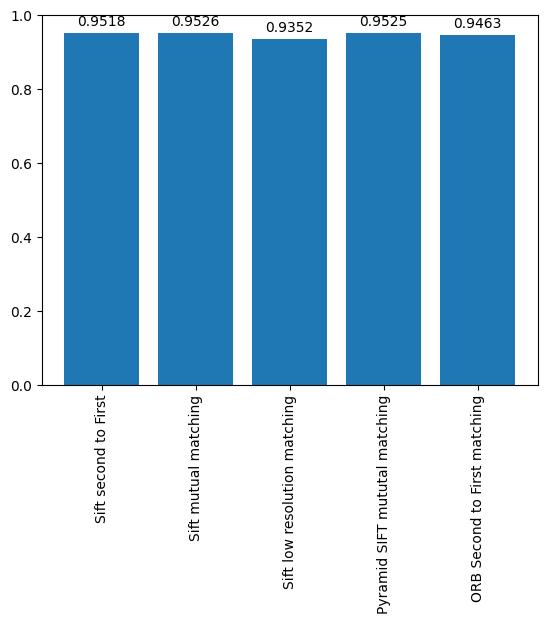

In [93]:
def calc_entropy(img: np.ndarray):
    hem = img[...,0]
    eos = img[...,1]
    hem_hist, _ = np.histogram(hem[hem > 0].flatten(), bins=256, range=(0.0, 1.0))
    eos_hist, _ = np.histogram(eos[eos > 0].flatten(), bins=256, range=(0.0, 1.0))

    hem_hist = hem_hist / hem_hist.sum()
    eos_hist = eos_hist / eos_hist.sum()

    hem_entropy = -np.sum(hem_hist * np.log2(hem_hist + np.finfo(float).eps))
    eos_entropy = -np.sum(eos_hist * np.log2(eos_hist + np.finfo(float).eps))

    return hem_entropy, eos_entropy

def entropy_S(img1: np.ndarray, img2: np.ndarray):
    entr1 = np.array(calc_entropy(img1))
    entr2 = np.array(calc_entropy(img2))
    similarity = 1 - np.abs(entr1 - entr2) / np.maximum(entr1, entr2)
    return  similarity.mean()

fig, ax = plt.subplots()
index_entropy = plot_index(match_dict, entropy_S, ax)
plt.show()

### Normalized Gradient Fields (NGF)

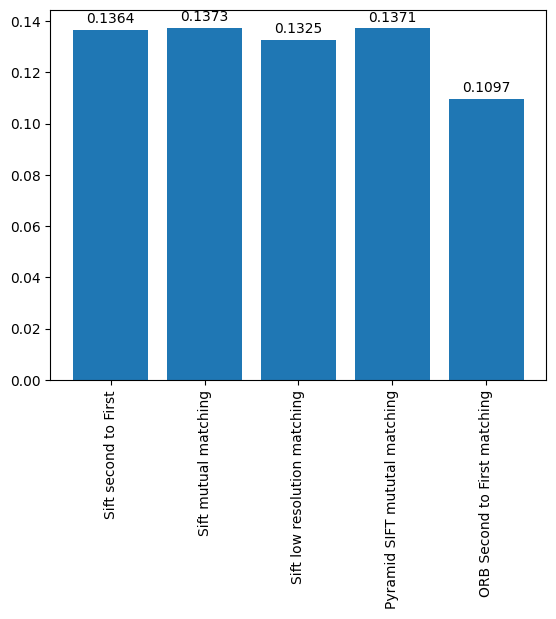

In [94]:
def normalized_gradient(img: np.ndarray):
    epsilon = 1e-8
    
    gx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=3)
    gy = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=3)

    mg = np.sqrt(gx**2 + gy**2) + np.finfo(float).eps
    nx = gx / mg
    ny = gy / mg

    return nx, ny

def ngf_index(img1: np.array, img2: np.array):
    assert img1.shape == img2.shape

    ch_index = []
    for img1_ch, img2_ch in zip(cv2.split(img1), cv2.split(img2)):
        nx1, ny1 = normalized_gradient(img1_ch)
        nx2, ny2 = normalized_gradient(img2_ch)

        dot_product = nx1 * nx2 + ny1 * ny2
        similarity = np.mean(dot_product**2)
        ch_index.append(similarity)

    return np.array(ch_index).mean()

fig, ax = plt.subplots()
index_ngf = plot_index(match_dict, ngf_index, ax)
plt.show()

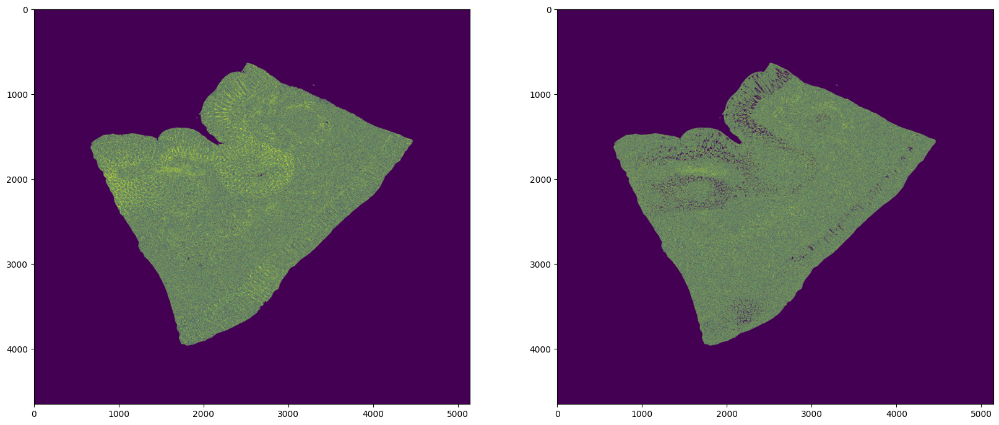

In [95]:
H = res_dict['Sift mutual matching']

hdx1, hdx2 = match_dict["Sift mutual matching"]
hem1 = hdx1[...,0]
eos1 = hdx1[...,1]
hem2 = hdx2[...,0]
eos2 = hdx2[...,1]

def sim_map(img1: np.ndarray, img2: np.ndarray):
    nx1, ny1 = normalized_gradient(img1)
    nx2, ny2 = normalized_gradient(img2)

    dot_product = nx1 * nx2 + ny1 * ny2
    similarity_map = dot_product ** 2
    return similarity_map

fig, axes = plt.subplots(1, 2, figsize=(20, 40))
hem_map = sim_map(hem1, hem2)
eos_map = sim_map(eos1, eos2)
axes[0].imshow(hem_map)
axes[1].imshow(eos_map)
plt.show()

## Non Affine image fitting

### NGF minimalization

In [ ]:
ref_ngf = normalized_gradient(hem1)
src_ngf = normalized_gradient(hem2)

def pyramid_ngf(ref_ngf: np.ndarray, src_ngf: np.ndarray, levels: int = 5):
    ref_pyr = [ref_ngf]
    src_pyr = [src_ngf]

    for _ in range(levels-1):
        ref_pyr.append(cv2.pyrDown(ref_pyr[-1]))
        src_pyr.append(cv2.pyrDown(src_pyr[-1]))
        
    
# Przygotowanie danych wejściowych dla optical flow
def prepare_flow_input(gx, gy):
    """Konwersja gradientów do postaci kąta w przestrzeni 8-bitowej"""
    angles = np.arctan2(gy, gx)  # Zakres [-π, π]
    normalized = (angles + np.pi) / (2 * np.pi)  # Normalizacja do [0, 1]
    return (normalized * 255).astype(np.uint8)

# Sprawdź wymiary obrazów
print(f"Shape hem1: {hem1.shape}, hem2: {hem2.shape}")

# Konwersja do obrazów 8-bitowych
ref_flow_input = prepare_flow_input(ref_ngf[0], ref_ngf[1])
src_flow_input = prepare_flow_input(src_ngf[0], src_ngf[1])

# Obliczanie przepływu optycznego
flow = cv2.calcOpticalFlowFarneback(
    prev=src_ngf,
    next=ref_ngf,
    flow=cv2.resize(cumulative_flow, (scaled_src.shape[1], scaled_src.shape[0])) if cumulative_flow is not None else None,
    pyr_scale=0.3,
    levels=5,
    winsize=15 + int(10*(1-scale)),
    iterations=8,
    poly_n=7,
    poly_sigma=1.5,
    flags=cv2.OPTFLOW_USE_INITIAL_FLOW
)

# Generowanie siatki współrzędnych
h, w = hem2.shape
X, Y = np.meshgrid(np.arange(w), np.arange(h))

# Tworzenie mapy przemieszczeń
map_x = (X + flow[..., 0]).astype(np.float32)
map_y = (Y + flow[..., 1]).astype(np.float32)

# Deformacja obrazu źródłowego
deformed = cv2.remap(
    hem2.astype(np.float32),
    map_x,
    map_y,
    interpolation=cv2.INTER_LINEAR,
    borderMode=cv2.BORDER_CONSTANT
)

Shape hem1: (4649, 5143), hem2: (4649, 5143)


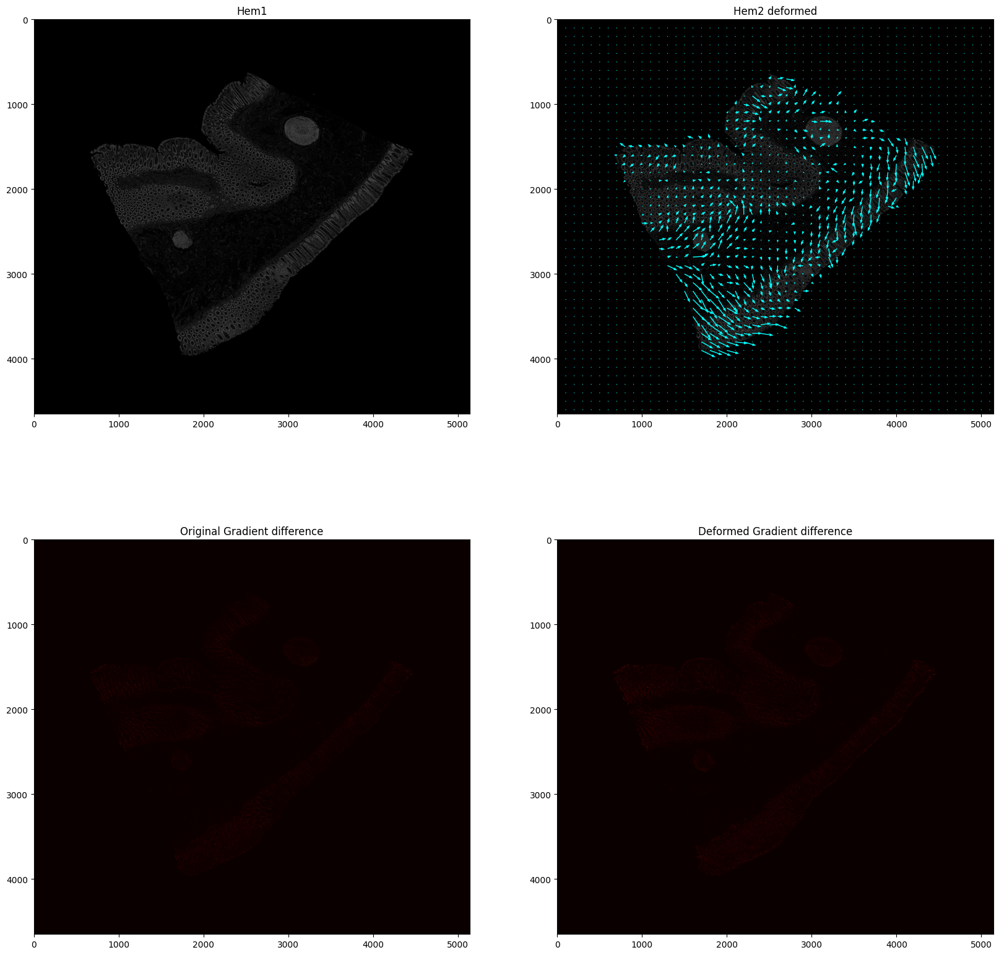

Original MSE: 0.0013413223269564125
Deformed MSE: 0.0014544601361271615


In [124]:
# Wizualizacja z siatką przekształceń
fig, axes = plt.subplots(2, 2, figsize=(20, 20))

# Obraz referencyjny
axes[0,0].imshow(hem1, cmap='gray')
axes[0,0].set_title('Hem1')

# Obraz zdeformowany z siatką przekształceń
axes[0,1].imshow(deformed, cmap='gray')
axes[0,1].set_title('Hem2 deformed')

# Dodaj siatkę przekształceń
step = 100  # Krok próbkowania strzałek
h, w = deformed.shape
Y, X = np.mgrid[0:h:step, 0:w:step]
U = flow[::step, ::step, 0] * 5  # Wzmocnienie przemieszczeń dla lepszej widoczności
V = flow[::step, ::step, 1] * 5

axes[0,1].quiver(X, Y, U, V, 
                color='cyan', 
                scale=1, 
                scale_units='xy',
                angles='xy',
                width=0.002,
                headwidth=3,
                headlength=4)

# Różnice gradientów
axes[1,0].imshow(img_grad(hem1[...,np.newaxis], hem2[...,np.newaxis]), cmap='hot')
axes[1,0].set_title('Original Gradient difference')
axes[1,1].imshow(img_grad(hem1[...,np.newaxis], deformed[...,np.newaxis]), cmap='hot')
axes[1,1].set_title('Deformed Gradient difference')

plt.show()
print(f"Original MSE: {mse(hem1, hem2)}")
print(f"Deformed MSE: {mse(hem1, deformed)}")

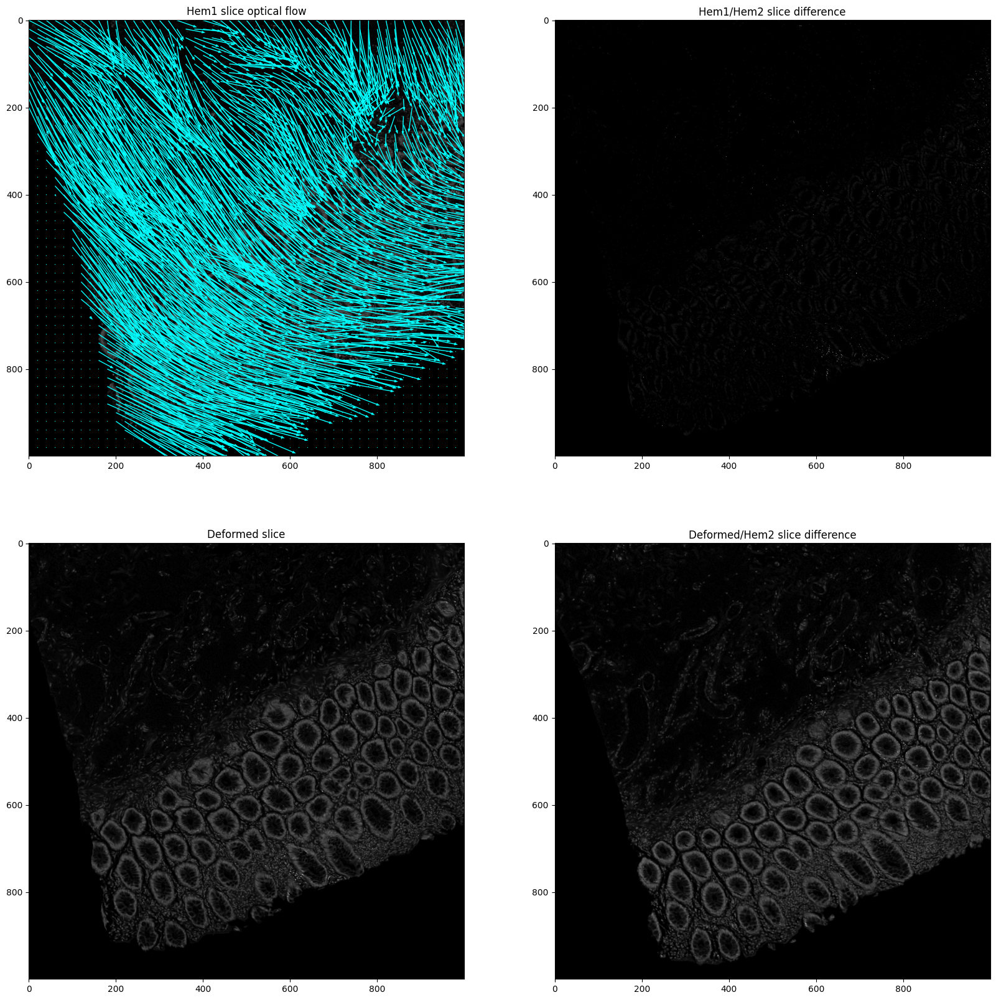

In [125]:
def ngf_flow_visualization(ax, hem1: np.ndarray, hem2: np.ndarray, flow: np.ndarray, step: int = 100):
    h, w = hem2.shape
    Y, X = np.mgrid[0:h:step, 0:w:step]
    U = flow[::step, ::step, 0] * 5  # Wzmocnienie przemieszczeń dla lepszej widoczności
    V = flow[::step, ::step, 1] * 5

    ax.imshow(hem2, cmap='gray')
    ax.quiver(X, Y, U, V,
              color='cyan',
              scale=1,
              scale_units='xy',
              angles='xy',
              width=0.002,
              headwidth=3,
              headlength=4)


sample_slice = (slice(3000, 4000),slice(1500, 2500))
hem1_slice = hem1[sample_slice]
hem2_slice = hem2[sample_slice]
deform_slice = deformed[sample_slice]
flow_slice = flow[sample_slice]

fig, axes = plt.subplots(2, 2, figsize=(20, 20))

ngf_flow_visualization(axes[0,0], hem1_slice, hem2_slice, flow[3000:4000, 1500:2500], step = 20)
axes[0,0].set_title('Hem1 slice optical flow')
axes[0,1].imshow((deform_slice - hem2_slice)**2, cmap='gray')
axes[0,1].set_title('Hem1/Hem2 slice difference')
axes[1,0].imshow(deform_slice, cmap='gray')
axes[1,0].set_title('Deformed slice')
axes[1,1].imshow(hem1_slice, cmap='gray')
axes[1,1].set_title('Deformed/Hem2 slice difference')
plt.show()